In [1]:
import pandas as pd
import numpy as np
import altair as alt
from vega_datasets import data
import geopandas
from shapely.geometry import Point

In [2]:
df = pd.read_csv("data/language.csv")

In [3]:
df.head()

,wals_code,iso_code,glottocode,Name,latitude,longitude,genus,family,macroarea,countrycodes,...,137B M in Second Person Singular,136B M in First Person Singular,109B Other Roles of Applied Objects,10B Nasal Vowels in West Africa,25B Zero Marking of A and P Arguments,21B Exponence of Tense-Aspect-Mood Inflection,108B Productivity of the Antipassive Construction,130B Cultural Categories of Languages with Identity of 'Finger' and 'Hand',58B Number of Possessive Nouns,79B Suppletion in Imperatives and Hortatives
0,aab,NaN,NaN,Arapesh (Abu),-3.450000,142.950000,Kombio-Arapesh,Torricelli,NaN,PG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,aar,aiw,aari1239,Aari,6.000000,36.583333,South Omotic,Afro-Asiatic,Africa,ET,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,aba,aau,abau1245,Abau,-4.000000,141.250000,Upper Sepik,Sepik,Papunesia,PG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,abb,shu,chad1249,Arabic (Abbéché Chad),13.833333,20.833333,Semitic,Afro-Asiatic,Africa,TD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,abd,abi,abid1235,Abidji,5.666667,-4.583333,Kwa,Niger-Congo,Africa,CI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
geometry = [Point(xy) for xy in zip(df['longitude'], df['latitude'])]
df = df.drop(['longitude', 'latitude'], axis=1)
crs = {'init': 'epsg:4326'}
gdf = geopandas.GeoDataFrame(df, crs=crs, geometry=geometry)

In [5]:
gdf.head()

,wals_code,iso_code,glottocode,Name,genus,family,macroarea,countrycodes,1A Consonant Inventories,2A Vowel Quality Inventories,...,136B M in First Person Singular,109B Other Roles of Applied Objects,10B Nasal Vowels in West Africa,25B Zero Marking of A and P Arguments,21B Exponence of Tense-Aspect-Mood Inflection,108B Productivity of the Antipassive Construction,130B Cultural Categories of Languages with Identity of 'Finger' and 'Hand',58B Number of Possessive Nouns,79B Suppletion in Imperatives and Hortatives,geometry
0,aab,NaN,NaN,Arapesh (Abu),Kombio-Arapesh,Torricelli,NaN,PG,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (142.95 -3.45)
1,aar,aiw,aari1239,Aari,South Omotic,Afro-Asiatic,Africa,ET,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (36.5833333333 6)
2,aba,aau,abau1245,Abau,Upper Sepik,Sepik,Papunesia,PG,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (141.25 -4)
3,abb,shu,chad1249,Arabic (Abbéché Chad),Semitic,Afro-Asiatic,Africa,TD,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (20.8333333333 13.8333333333)
4,abd,abi,abid1235,Abidji,Kwa,Niger-Congo,Africa,CI,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-4.58333333333 5.666666666669999)


In [6]:
# convert `gdf` into a json for integration capabilities with altair
json_data  = alt.InlineData(values = gdf.to_json(), #geopandas to geojson string
                       # root object type is "FeatureCollection" but we need its features
                       format = alt.DataFormat(property='features',type='json'))

# grab country shapes
countries = alt.topo_feature(data.world_110m.url, 'countries')

In [7]:
# preset elements
projection = 'equirectangular'
h = 560
w = 800

In [8]:
points = alt.Chart(json_data).mark_geoshape(
    opacity=.5,
    size=1
).encode( 
    fill='properties.family:N',  
    tooltip='properties.Name:N',
    stroke='properties.family:N'
).properties( 
    projection={"type":projection},
    width=w,
    height=h
)

In [9]:
base = alt.Chart(countries).mark_geoshape(
    fill='#666662',
    stroke='white'
).properties(
    width=w,
    height=h
).project(projection)

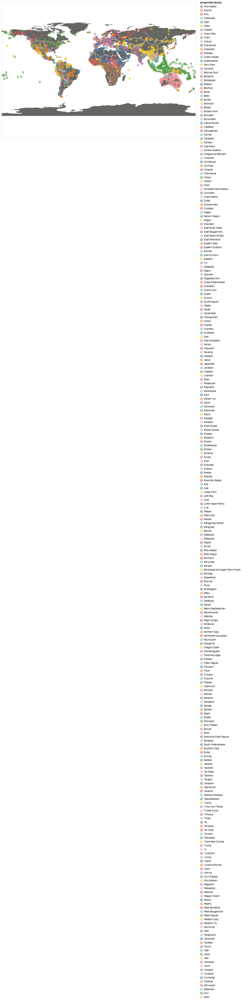

In [10]:
base + points

# Appendix

1. [Building Blocks of Interactions](https://altair-viz.github.io/user_guide/selections.html). A reference document of how to modularize your interactions within an Altair plot.
2. [Marks](https://altair-viz.github.io/user_guide/marks.html). A reference to the different types of marked representations of an Altair plot. If you are familiar with `R`'s `ggplot2` package, these would be known as *geoms*.
3. [`pandas` `DataFrame` to `GeoDataFrame`](https://gis.stackexchange.com/questions/174159/convert-a-pandas-dataframe-to-a-geodataframe). A post referencing how to convert a `pandas.DataFrame` into a `geopandas.GeoDataFrame`. This post is particularly helpful for converting long/lat coords into point geometries.
4. [`geopandas` Integration solution with `Altair`](https://github.com/altair-viz/altair/issues/588). This github issue dives into how integrate `geopandas` with `Altair`.
5. [Location of US Airports](https://altair-viz.github.io/gallery/airports.html). An example of how to plot point geometries.
6. [Encodings](https://altair-viz.github.io/user_guide/encoding.html). A reference document of how to use encodings which in `ggplot2`'s terms would be *aesthetics*.